# 🚀 Inference and Explainability on WSI

Welcome to the last part of the workshop! In this notebook, we will focus on the inference and explainability of the model trained on the WSI dataset from the previous notebooks. We will use the trained model to make predictions on the test set and then explain the predictions using CAM.

### Notebook Structure 📚

1. Inference on the Test Set 🧪
2. Explainability 🧠

**Authors:**<br>
&copy; 2024; Matěj Pekár, Jakub Pekár, Vít Musil


Before we start, let's install the required libraries:


In [1]:
!pip uninstall -y rationai-mlkit
!pip install torch torchvision matplotlib albumentations pandas mlflow tqdm \
    git+https://git@gitlab.ics.muni.cz/rationai/digital-pathology/libraries/mlkit.git

Found existing installation: rationai-mlkit 0.1.15
Uninstalling rationai-mlkit-0.1.15:
  Successfully uninstalled rationai-mlkit-0.1.15
  Cloning https://****@gitlab.ics.muni.cz/rationai/digital-pathology/libraries/mlkit.git to /tmp/pip-req-build-easgghst
  Running command git clone --filter=blob:none --quiet 'https://****@gitlab.ics.muni.cz/rationai/digital-pathology/libraries/mlkit.git' /tmp/pip-req-build-easgghst
  Resolved https://****@gitlab.ics.muni.cz/rationai/digital-pathology/libraries/mlkit.git to commit d431d430b7659662f2cd4e93d82a030189bb598a
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for rationai-mlkit: filename=rationai_mlkit-0.1.15-py3-none-any.whl size=14671 sha256=90456b08ddeea3ce428717cdbfcc36c203e3a8a6c43f634a38cb448ec41363e0
  Stored in directory: /tmp/pip-ephem-wheel-cache-llegi4zz/wheels/b4/86/86/9dc32ff519a8014f54d520210d4eae197542da3648feff9fe5
Successfull

## 1. Inference on the Test Set 🧪

---

In this section, we'll demonstrate **how to perform model inference** on a tiled dataset and **compose predictions** from individual tiles to cover the entire slide.

Before we start the inference process, we need to set up the following components:

- **Dataset**: Load the test data and split it into tiles.
- **Dataloaders**: Efficiently load the tiles for model inference.
- **Model**: Initialize the model and load a pre-trained checkpoint.
- **Download Checkpoint**: If the model checkpoint is not available locally, we'll download it.

<div class="alert alert-success code">
    <h3>TASK 1.01</h3>
    <p>
        Fill envs with your MLflow login credentials...
    </p>
</div>


In [2]:
%env MLFLOW_TRACKING_USERNAME=bednařík_kryštof
%env MLFLOW_TRACKING_PASSWORD=dfgwXV9YKpo

env: MLFLOW_TRACKING_USERNAME=bednařík_kryštof
env: MLFLOW_TRACKING_PASSWORD=dfgwXV9YKpo


Datasets:


In [3]:
from collections.abc import Iterable
from typing import TypeAlias

import albumentations as A
import pandas as pd
import torch
from albumentations.pytorch import ToTensorV2
from rationai.mlkit.data import MLFlowSlides, SlideTiles
from torch import Tensor
from torch.utils.data import Dataset


Sample: TypeAlias = tuple[Tensor, Tensor]


class BreastCancer(MLFlowSlides):
    def __init__(
        self,
        uris: list[str],
        cancer_threshold: float,
        transforms: A.TransformType | None = None,
    ) -> None:
        self.transforms = transforms
        self.cancer_threshold = cancer_threshold
        super().__init__(uris)

    def generate_datasets(self) -> Iterable[Dataset]:
        self.tiles["cancer"] = self.tiles["cancer_coverage"] > self.cancer_threshold

        return (
            BreastCancerSlideTiles(
                slide, self.filter_tiles_by_slide(slide.path), self.transforms
            )
            for slide in self.slides.itertuples()
        )


class BreastCancerSlideTiles(SlideTiles):
    def __init__(
        self,
        slide_labels,
        tiles: pd.DataFrame,
        transforms: A.TransformType | None = None,
    ) -> None:
        super().__init__(
            slide_path=slide_labels.path,
            level=slide_labels.level,
            tile_height=slide_labels.tile_height,
            tile_width=slide_labels.tile_width,
            tiles=tiles,
        )

        self.slide_width = slide_labels.slide_width
        self.slide_height = slide_labels.slide_height
        self.stride_x = slide_labels.stride_x
        self.stride_y = slide_labels.stride_y
        self.transforms = transforms
        self.to_tensor = ToTensorV2()

    def __getitem__(self, idx: int) -> tuple[Tensor, Tensor, Tensor]:  # type: ignore [override]
        image = super().__getitem__(idx)
        tile = self.tiles.iloc[idx]
        label = tile["cancer"]

        if self.transforms is not None:
            image = self.transforms(image=image)["image"]

        return (
            self.to_tensor(image=image)["image"],
            torch.tensor([label]).float(),
            torch.tensor([tile["x"], tile["y"]]),
        )

In [4]:
import torchvision
from torch import nn


def resnet18(weights: str | None = None) -> nn.Module:
    resnet = torchvision.models.resnet18(weights=weights)
    return nn.Sequential(*(list(resnet.children())[:-2]))

In [5]:
from torch import Tensor, nn


class BinaryClassifier(nn.Module):
    def __init__(self) -> None:
        super().__init__()
        self.global_pool = nn.AdaptiveAvgPool2d(1)
        self.dropout = nn.Dropout(p=0.5)
        self.proj = nn.Linear(512, 1)

    def forward(self, x: Tensor) -> Tensor:
        x = self.global_pool(x)  # (B, C, 1, 1)
        x = x.flatten(start_dim=-3, end_dim=-1)  # (B, C)
        x = self.dropout(x)
        x = self.proj(x)
        return x.sigmoid()

In [6]:
from lightning import LightningModule
from torch import Tensor


class BreastCancerModel(LightningModule):
    def __init__(self) -> None:
        super().__init__()
        self.backbone = resnet18()
        self.decode_head = BinaryClassifier()

    def forward(self, x: Tensor) -> Tensor:
        features = self.backbone(x)
        return self.decode_head(features)

In [7]:
import mlflow


ckpt_path = "mlflow-artifacts:/14/d3b230eae41844bba94f2535e8b57fbe/artifacts/checkpoints/epoch=0-step=110/epoch=0-step=110.ckpt"  # TODO: load Breast Cancer checkpoint
ckpt_path = mlflow.artifacts.download_artifacts(ckpt_path)

model = BreastCancerModel.load_from_checkpoint(ckpt_path).eval()

In [8]:
test_transforms = A.Normalize(
    mean=(199.1039, 156.5951, 185.4386),
    std=(36.3415, 48.6343, 36.3027),
    max_pixel_value=1,
)

### Assembling the Heatmap for Whole Slides 🌍

After processing all the tiles, the next step is to **assemble them back together** to create a complete view of the whole slide. We do this by combining the predictions from each tile to generate a **heatmap**.

- The heatmap is a visual representation of the model's output across the entire slide. It highlights **areas of interest**, such as tumor regions, based on the predictions from each tile.
- Since we used **overlapping tiles**, multiple predictions will cover the same regions. To handle this overlap, we can **average** the predictions in the overlapping areas to ensure smooth transitions between the tiles.

🛠 **Note**: Due to the computational limits of the Jupyter Hub environment, we will only run the inference for a **single slide** in this tutorial.

<style>
code {
    color: purple;
    background-color: #f0f0f0;
}
</style>

<div class="alert alert-success code">
    <h3>TASK 1.02</h3>
    <p>
        <ol>
            <li> Calculate the heatmap dimensions (height and width) based on the size of the slide, tile size, and stride size. If you are not sure about the formula, try asking ChatGPT.
            <li> Complete the <code>__call__</code> function in the <code>HeatmapAssembler</code> class to update the heatmap using the incoming predictions. Remember that due to <b>tile overlapping</b>, a single tile might overlap with multiple heatmap regions, so make sure to handle these overlaps correctly.
        </ol>
    </p>
</div>

As you work through this, think about what the minimal heatmap size would be relative to the slide size, tile size, and stride. The objective is to build a heatmap that is as compact as possible without losing any information. An example: having tile size 512, stride size 128 and the width of slide 1600 the desired heatmap widht should be 9.


In [9]:
import math

import numpy as np
from numpy.typing import NDArray


class HeatmapAssembler:
    def __init__(
        self,
        slide_height: int,
        slide_width: int,
        tile_height: int,
        tile_width: int,
        stride_y: int,
        stride_x: int,
    ) -> None:
        self.heatmap_height = ((slide_height - tile_height) // stride_y) + 1
        self.heatmap_width = ((slide_width - tile_width) // stride_x) + 1  
        self.heatmap_accumulator = np.zeros((self.heatmap_height, self.heatmap_width))
        self.counter = np.zeros((self.heatmap_height, self.heatmap_width))

        self.scaled_height = math.ceil(tile_height / stride_y)
        self.scaled_width = math.ceil(tile_width / stride_x)
        self.stride_y = stride_y
        self.stride_x = stride_x

    def __call__(self, tiles, predictions) -> None:
        for (x, y), prediction in zip(tiles, predictions):
            # Get the region of interest in the heatmap for the current tile
            roi = self._get_roi(x, y)
            # Accumulate predictions in the heatmap for the specified ROI
            self.heatmap_accumulator[roi] += prediction
            # Update the counter to track the number of times each region is updated
            self.counter[roi] += 1


    def _get_roi(self, x: int, y: int) -> tuple[slice, slice]:
        return (
            slice(y // self.stride_y, y // self.stride_y + self.scaled_height),
            slice(x // self.stride_x, x // self.stride_x + self.scaled_width),
        )

    def finalize(self) -> NDArray[np.float64]:
        return np.divide(
            self.heatmap_accumulator, self.counter, where=self.counter != 0
        )


Now that we've discussed the theory behind assembling the heatmap from tiles, let's put it into action using the `HeatmapAssembler` class.

### Steps to Generate the Heatmap 🧱

1. **Prepare Dataset and Dataloader**
2. **Initialize the `HeatmapAssembler`**
3. **Loop over Batches:**
4. **Update the Heatmap:**
5. **Visualize the Heatmap**


In [10]:
from torch.utils.data import DataLoader


DATASET_URI = "mlflow-artifacts:/9/dc5914761b114c8c9af011ddb546f6a9/artifacts/Breast Cancer - test"

dataset = BreastCancer(
    uris=[DATASET_URI],
    cancer_threshold=0.5,
    transforms=test_transforms,
)

<div class="alert alert-success code">
    <h3>TASK 1.03</h3>
    <p>
        Complete the missing code to implement heatmap assembling
    </p>
</div>


In [11]:
from tqdm import tqdm

WSI_LEVEL = 3
BATCH_SIZE = 8

def generate_heatmap(dataset_idx):
    single_slide_dataset = dataset.datasets[dataset_idx] # Select single dataset -> only data within one WSI
    dataloader = DataLoader(single_slide_dataset, batch_size=BATCH_SIZE, shuffle=False, drop_last=False)

    heatmap_assembler = HeatmapAssembler(
        slide_height=single_slide_dataset.slide_height,
        slide_width=single_slide_dataset.slide_width,
        tile_height=single_slide_dataset.tile_height,
        tile_width=single_slide_dataset.tile_width,
        stride_y=single_slide_dataset.stride_y,
        stride_x=single_slide_dataset.stride_x,
    )

    with torch.no_grad():
        # TODO:
        # Iterate over batches from the dataloader
        # **NOTE**: Each batch from the dataset returns a triplet consisting of an image, a label, and tile coordinates (x, y).
        # Add a progress bar using tqdm for tracking the iteration progress.
        # Pass each batch through the model to obtain predictions.
        # Forward the predictions along with their corresponding tile coordinates to the `heatmap_assembler`.
        
        # Iterate over batches from the dataloader with progress bar
        for images, labels, tile_coords in tqdm(dataloader, desc="Processing tiles", unit="batch"):
            predictions = model(images)  # Obtain model predictions
            prediction = predictions.cpu().numpy()  # Convert prediction to NumPy
            heatmap_assembler(tile_coords, prediction)  # Update heatmap with the prediction and coordinates


    slide = pyvips.Image.new_from_file(single_slide_dataset.slide_path, page=WSI_LEVEL)
    return slide, heatmap_assembler.finalize()

In [12]:
import matplotlib.pyplot as plt
import pyvips
from PIL import Image
from matplotlib.colors import Normalize


# Displays heatmap as overlay over original WSI
def display_heatmap(slide, heatmap):
    background = Image.fromarray(slide.numpy()).convert("RGBA")

    cmap = plt.get_cmap("seismic")
    norm = Normalize(vmin=0, vmax=1)  # Normalize the values to 0-1 range
    colored_heatmap = cmap(norm(heatmap))

    # Remove the alpha channel
    colored_heatmap = (colored_heatmap[:, :, :3] * 255).astype(np.uint8)

    # Convert to PIL Image
    heatmap_image = (
        Image.fromarray(colored_heatmap).convert("RGBA").resize(background.size)
    )
    heatmap_image.putalpha(100)

    Image.alpha_composite(background, heatmap_image).convert("RGB").show()

<div class="alert alert-success code">
    <h3>TASK 1.04</h3>
    <p>
        Explore and experiment! Examine different slides to gain insights into the model's predictions and how they vary across different images.
    </p>
</div>


Processing tiles:   0%|          | 0/84 [00:00<?, ?batch/s]/tmp/ipykernel_11430/1732152456.py:70: DeprecationWarning: In future, it will be an error for 'np.bool' scalars to be interpreted as an index
  torch.tensor([label]).float(),
Processing tiles: 100%|██████████| 84/84 [01:41<00:00,  1.21s/batch]


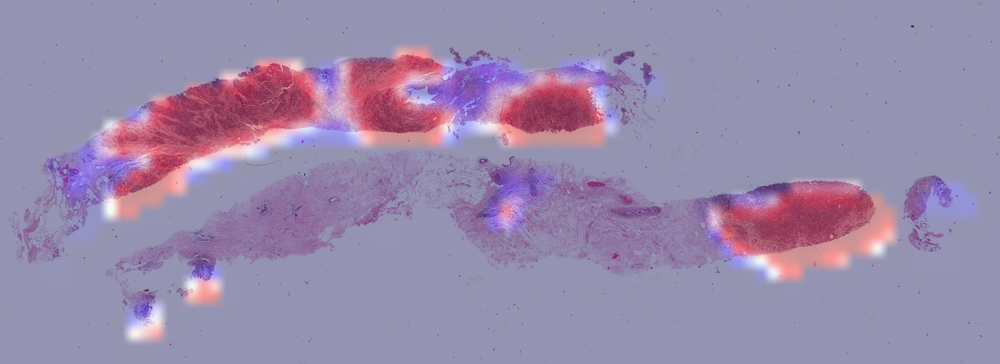

In [13]:
SLIDE_INDEX = 5

display_heatmap(*generate_heatmap(SLIDE_INDEX))

## 2. Explainability 🧠

In this part, we’ll apply explainability techniques to **Whole Slide Images (WSIs)**. The process will be similar to what we've done before, but this time we need to account for overlapping tiles and efficiently aggregate the results.

We’ll use the **Class Activation Map (CAM)** method to visualize the most important regions of the image that contribute to the model's predictions. CAM is a technique used to highlight the regions in an image that the model focuses on to make its decision. It works by taking advantage of the final layers of a Convolutional Neural Network (CNN), particularly using the weighted average of feature maps right before the global pooling layer. This creates a heatmap showing which parts of the image are the most influential for the model's output.

<img src="https://erdem.pl/static/42f10b034bf6a7ab1fc62aa76cc7734a/21b4d/cam-structure.png">

Firstly we need to prepare our inputs and targets:


<style>
code {
    color: purple;
    background-color: #f0f0f0;
}
</style>

<div class="alert alert-success code">
    <h3>TASK 2.01: Select Tile for CAM</h3>
    <p>
        Your task is to select indices of tiles to generate heatmaps for. We recommend selecting those where the models confidence was low (e.g. around 0.5)
    </p>
</div>


In [14]:
dataloader = DataLoader(dataset, batch_size=1, shuffle=False, drop_last=False)
INDICES = []
with torch.no_grad():
        counter = 0
        for i, (images, labels, tile_coords) in enumerate(tqdm(dataloader, desc="Processing tiles", unit="batch")):
            predictions = model(images).squeeze()
            prediction = predictions.cpu().numpy()
            if 0.4 <= prediction <= 0.6:
                counter += 1
                INDICES.append(i)
            if i > 1000 or counter >= 15:
                break

print(INDICES)

Processing tiles:   0%|          | 0/11152 [00:00<?, ?batch/s]/tmp/ipykernel_11430/1732152456.py:70: DeprecationWarning: In future, it will be an error for 'np.bool' scalars to be interpreted as an index
  torch.tensor([label]).float(),
Processing tiles:   1%|          | 93/11152 [00:12<24:14,  7.60batch/s]

[12, 14, 18, 20, 21, 24, 29, 39, 45, 47, 67, 75, 89, 90, 93]


Now we will load the tiles based on the `INDICES` selected in the previous step:


In [15]:
import albumentations as A


dataset = BreastCancer(
    uris=[
        "mlflow-artifacts:/9/dc5914761b114c8c9af011ddb546f6a9/artifacts/Breast Cancer - test"
    ],
    cancer_threshold=0.5,
)
dataset_norm = BreastCancer(
    uris=[
        "mlflow-artifacts:/9/dc5914761b114c8c9af011ddb546f6a9/artifacts/Breast Cancer - test"
    ],
    cancer_threshold=0.5,
    transforms=test_transforms,
)

inputs, targets, _ = zip(*[dataset[i] for i in INDICES], strict=True)
inputs, targets = torch.stack(inputs), torch.stack(targets)

inputs_normalized = torch.stack([dataset_norm[i][0] for i in INDICES])

/tmp/ipykernel_11430/1732152456.py:70: DeprecationWarning: In future, it will be an error for 'np.bool' scalars to be interpreted as an index
  torch.tensor([label]).float(),


<style>
code {
    color: purple;
    background-color: #f0f0f0;
}
</style>

<div class="alert alert-success code">
    <h3>TASK 2.02: CAM</h3>
    <p>
        Your task is to implement the <code>get_single_class_cam</code> method. This method will compute the Class Activation Map for a specific class. It should take an image as input and return a heatmap of the same size, scaled to the range [0, 1].
    </p>
</div>


In [28]:
import torch
import torch.nn.functional as F
from torch import Tensor
from torchvision.transforms import Resize


@torch.no_grad()
def get_single_class_cam(x: Tensor) -> Tensor:
    features = model.backbone(x)
    weights = model.decode_head.proj.weight
    
    weighted_sum = torch.sum(features * weights[..., None, None], 1)
    resized = Resize((x.shape[2], x.shape[3]))
    r = resized(weighted_sum)
    scaled = torch.sigmoid(r)
    
    return scaled

Next, let's calculate predictions and the CAM for the selected tiles


In [29]:
with torch.no_grad():
    preds = model(inputs_normalized)

attribute = get_single_class_cam(inputs_normalized).squeeze()

torch.Size([15, 512, 16, 16]) torch.Size([1, 512])
torch.Size([15, 3, 512, 512])


And finally, let's visualize the CAM heatmaps for the selected tiles:


In [30]:
import matplotlib.pyplot as plt
import torch


plt.style.use("ggplot")


def plot_occlusions(
    background: torch.Tensor,  # (H, W, C)
    attribute: torch.Tensor,  # (H, W)
    target: torch.Tensor,
    prediction: torch.Tensor,
    **kwargs,
) -> None:
    fig, axs = plt.subplots(1, 3, figsize=(15, 6))
    axs[0].imshow(background)
    axs[0].set_title("Background")

    mask = axs[1].imshow(attribute, cmap=plt.cm.seismic, **kwargs)
    axs[1].set_title("Attribute")

    axs[2].imshow(background)
    axs[2].pcolormesh(attribute, cmap=plt.cm.seismic, alpha=0.5, **kwargs)
    axs[2].set_title("Overlay")

    for ax in axs:
        ax.axis("off")
        ax.ticks = None

    fig.colorbar(mask, ax=axs, location="bottom")
    fig.suptitle(f"Prediction: {prediction.item():.2f} Target: {target.item():.2f}")
    fig.show()

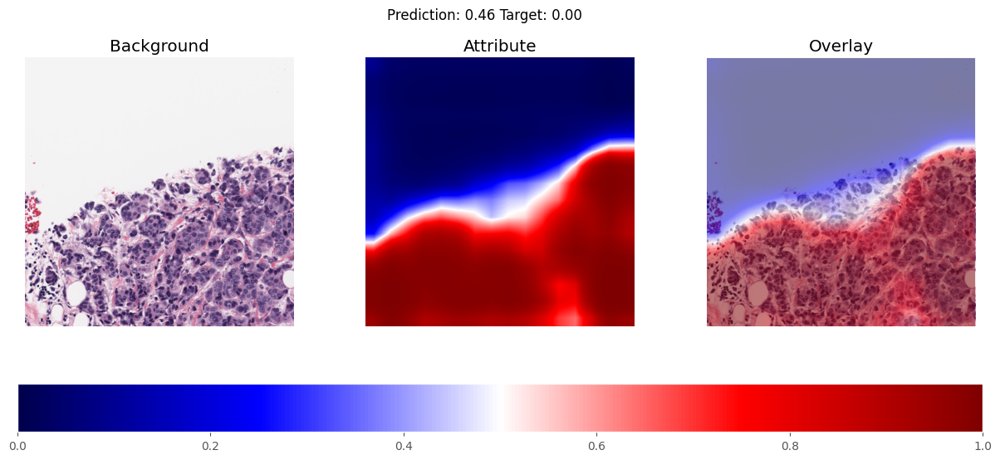

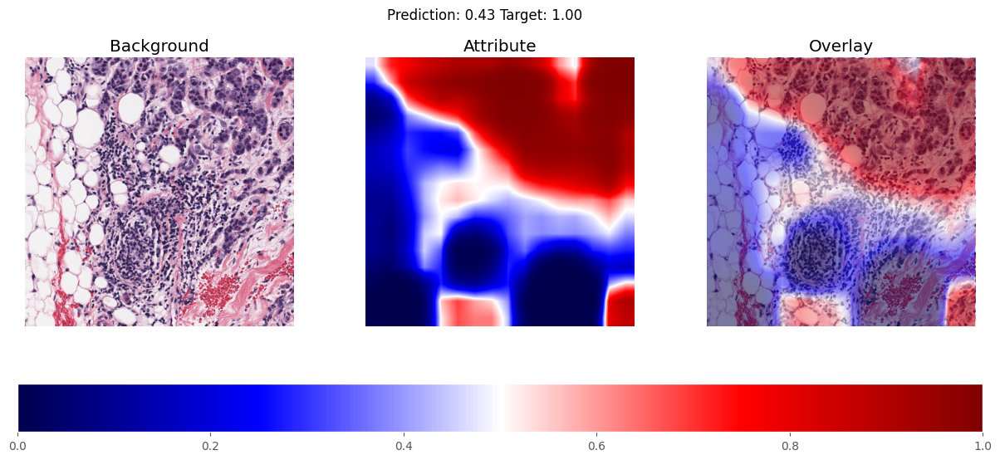

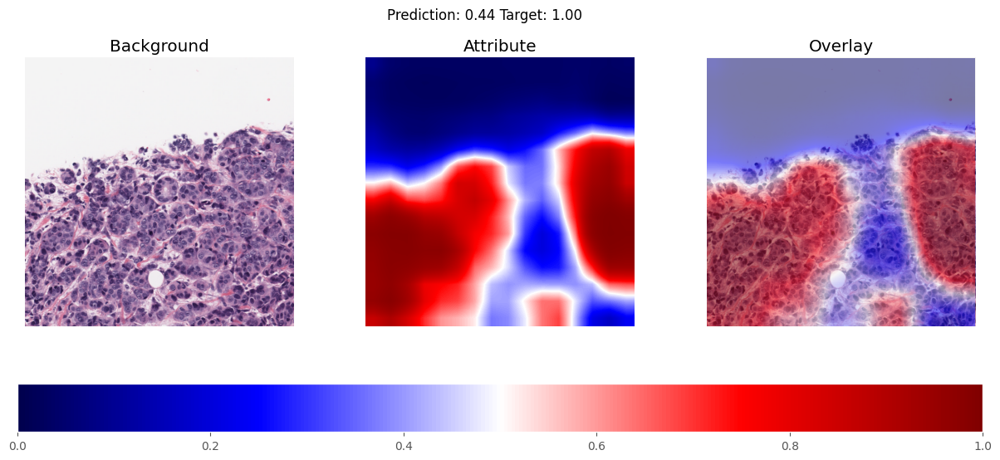

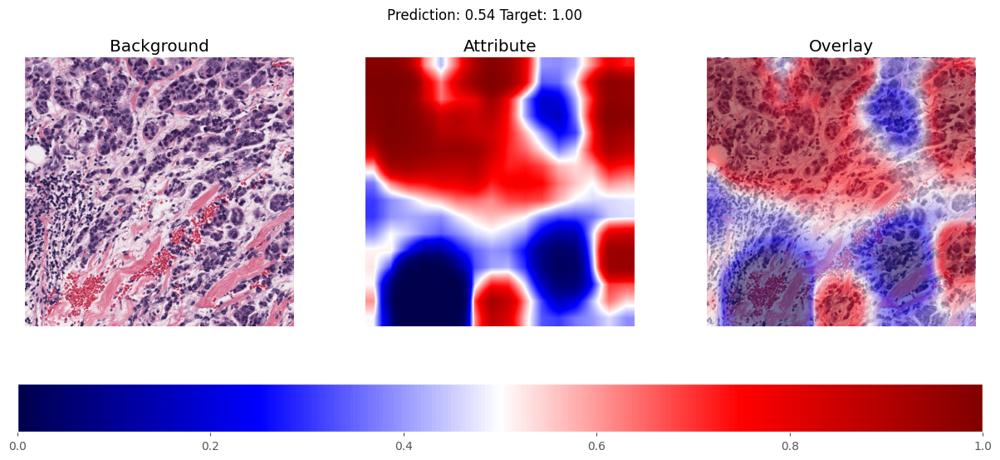

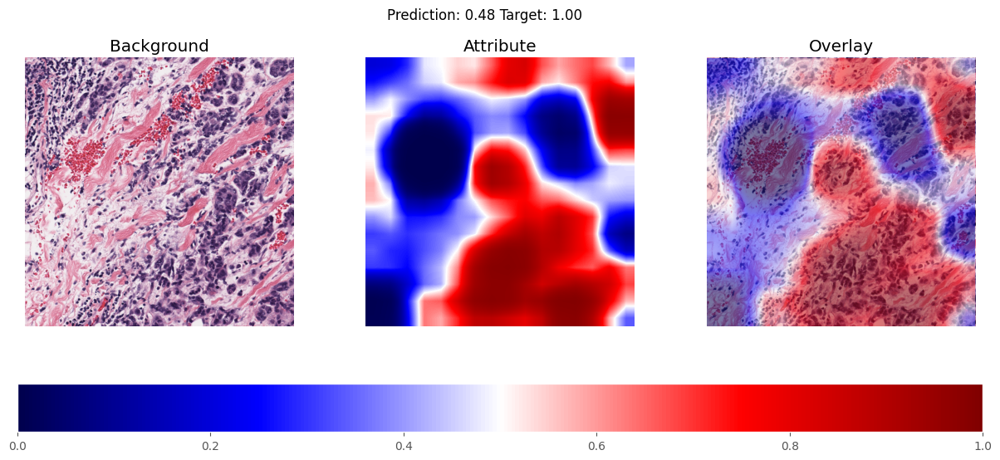

...

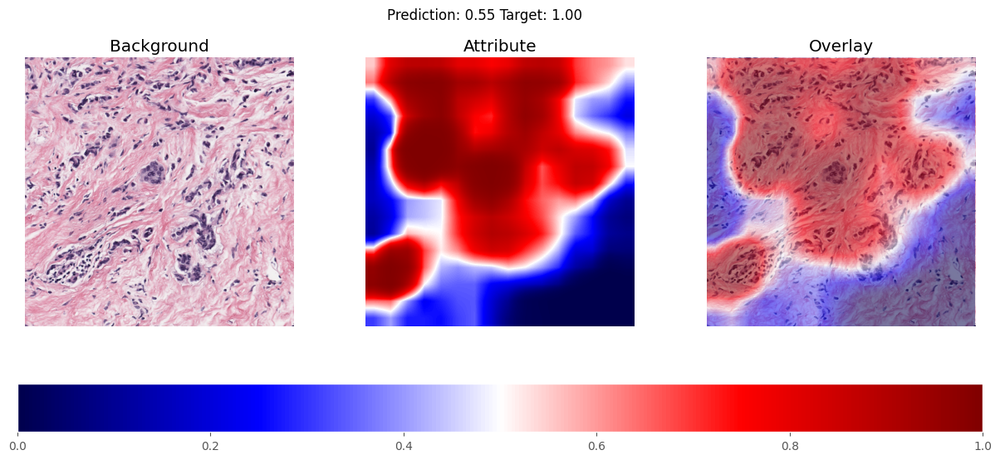

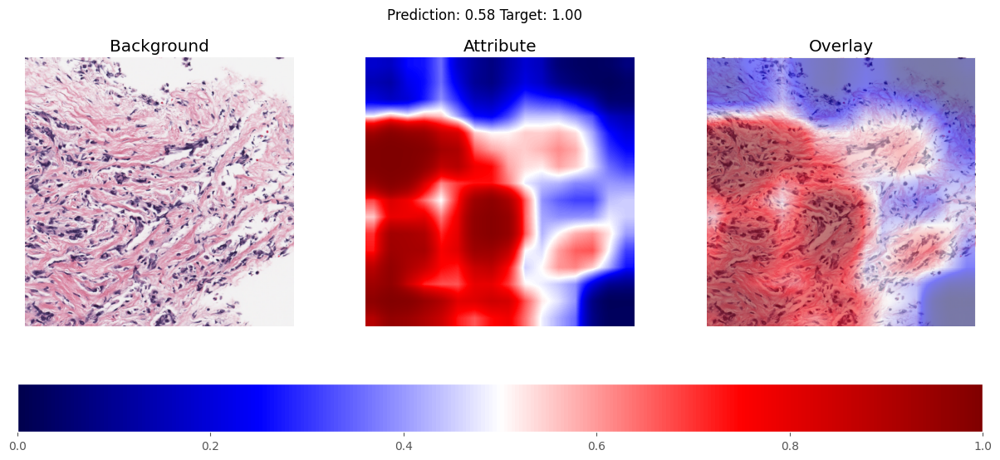

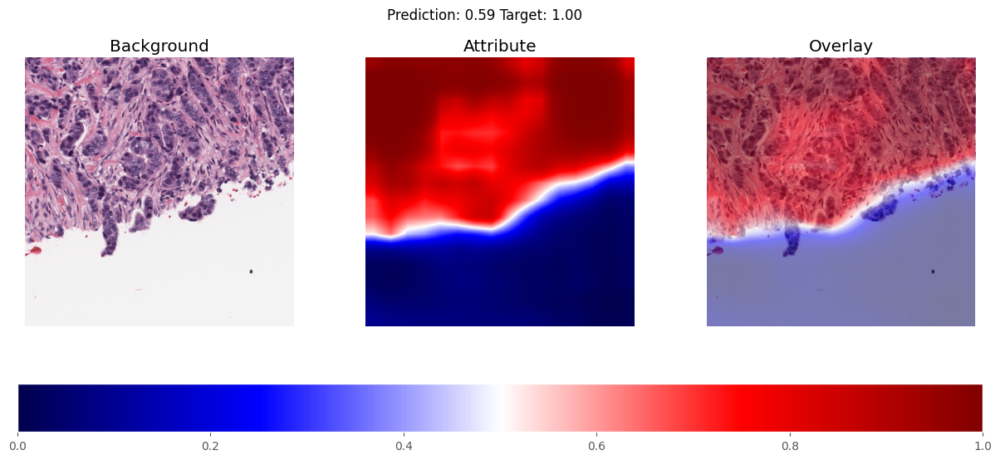

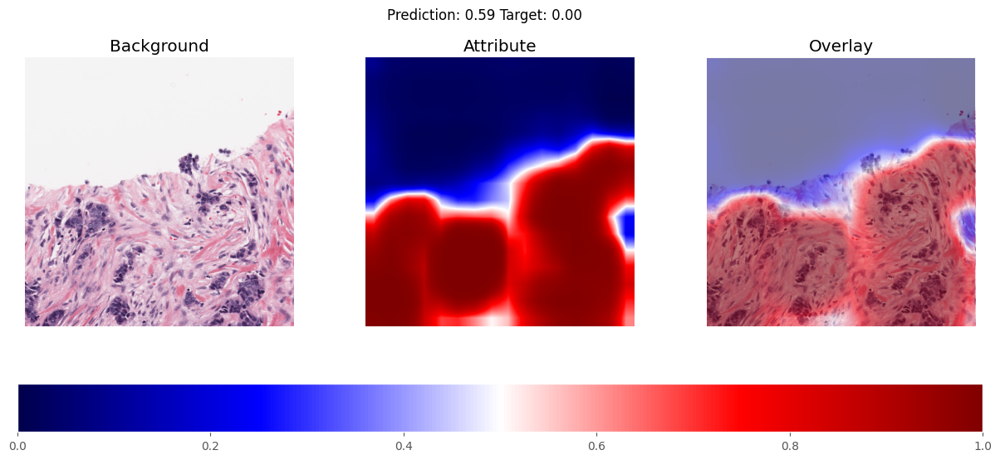

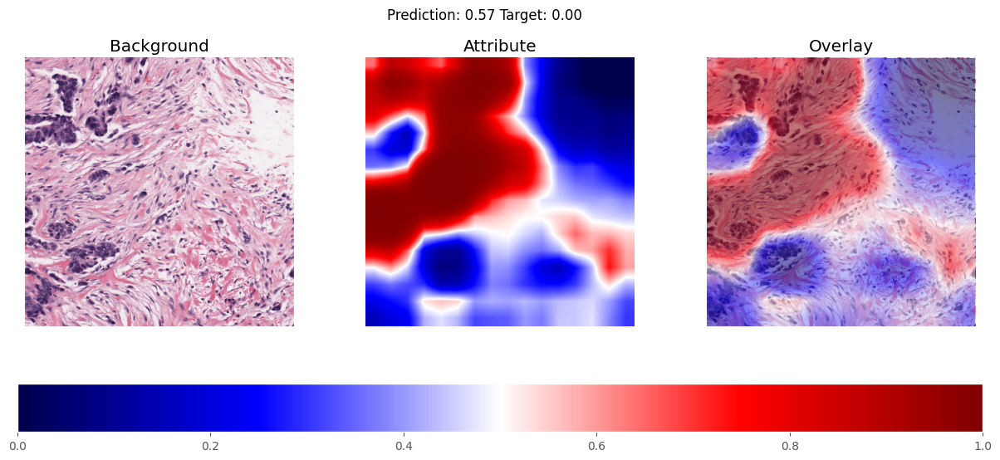

In [31]:
for i in range(len(INDICES)):
    plot_occlusions(
        background=inputs[i].permute(1, 2, 0),
        attribute=attribute[i],
        target=targets[i],
        prediction=preds[i],
        vmin=0,
        vmax=1,
    )

#### And that's it! 🥳

If you're up for a challenge, you can try implementing other CAM-based methods such as **HiResCAM**, **Grad-CAM**, **Grad-CAM++**, etc., using the same approach we followed for the basic CAM method.

Each of these methods builds upon the original CAM idea but adds more sophistication:

- **HiResCAM**: Provides high-resolution explanations, improving clarity and detail in the heatmaps.

- **Grad-CAM**: Combines gradients with the activation maps to provide a better localization of important regions. It uses the gradients of the target class flowing into the final convolutional layer to compute importance weights.

- **Grad-CAM++**: An extension of Grad-CAM, offering more refined visualizations, particularly for complex or overlapping objects in an image.

These techniques can be implemented similarly, but with slight variations in how the heatmaps are generated. Trying them out will give you a broader understanding of how different methods interpret the model's focus across images.
